In [3]:
import pandas as pd

In [4]:
df = pd.read_csv("C:/Users/HP/Downloads/ICRISAT-District Level Data - ICRISAT-District Level Data.csv")

In [5]:
df.shape
from tabulate import tabulate as t
print(t(df,headers="keys",tablefmt='psql'))

+-------+-------------+--------+--------------+------------------+-----------------------------------------+-----------------------+-------------------------------+--------------------------+------------------------+--------------------------------+---------------------------+---------------------------------+-----------------------------------------+------------------------------------+-------------------------------+---------------------------------------+----------------------------------+--------------------------+----------------------------------+-----------------------------+-------------------------------+---------------------------------------+----------------------------------+------------------------+--------------------------------+---------------------------+--------------------------------+----------------------------------------+-----------------------------------+-------------------------+---------------------------------+----------------------------+-------------------

In [6]:
df.isnull().sum()

Dist Code                               0
Year                                    0
State Code                              0
State Name                              0
Dist Name                               0
                                       ..
VEGETABLES AREA (1000 ha)               0
FRUITS AND VEGETABLES AREA (1000 ha)    0
POTATOES AREA (1000 ha)                 0
ONION AREA (1000 ha)                    0
FODDER AREA (1000 ha)                   0
Length: 80, dtype: int64

In [7]:
df1 = pd.DataFrame(df)
df_types = pd.DataFrame(df.dtypes, columns=['Data Type']).reset_index()
df_types.columns = ['Column Name', 'Data Type']

# Tabulate the result
print(t(df_types, headers='keys', tablefmt="psql"))

+----+---------------------------------------------+-------------+
|    | Column Name                                 | Data Type   |
|----+---------------------------------------------+-------------|
|  0 | Dist Code                                   | int64       |
|  1 | Year                                        | int64       |
|  2 | State Code                                  | int64       |
|  3 | State Name                                  | object      |
|  4 | Dist Name                                   | object      |
|  5 | RICE AREA (1000 ha)                         | float64     |
|  6 | RICE PRODUCTION (1000 tons)                 | float64     |
|  7 | RICE YIELD (Kg per ha)                      | float64     |
|  8 | WHEAT AREA (1000 ha)                        | float64     |
|  9 | WHEAT PRODUCTION (1000 tons)                | float64     |
| 10 | WHEAT YIELD (Kg per ha)                     | float64     |
| 11 | KHARIF SORGHUM AREA (1000 ha)               | float64  

In [8]:
# Fill numeric columns with median (for robustness)
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns

for col in numeric_cols:
    if df[col].isnull().sum() > 0:
        median_val = df[col].median()
        df[col].fillna(median_val, inplace=True)
        print(f"🛠️ Filled missing values in '{col}' with median: {median_val}")

# Drop columns with over 30% missing values
threshold = 0.3
cols_to_drop = [col for col in df.columns if df[col].isnull().mean() > threshold]
df.drop(columns=cols_to_drop, inplace=True)

print("\n🧹 Dropped columns with >30% missing values:", cols_to_drop)

# Verify after cleaning
missing_after = df.isnull().sum()
print("\n✅ Missing Values (After Cleaning):\n", missing_after[missing_after > 0])



🧹 Dropped columns with >30% missing values: []

✅ Missing Values (After Cleaning):
 Series([], dtype: int64)


In [9]:
print(t(df.head(),headers='keys',tablefmt='psql'))

+----+-------------+--------+--------------+--------------+-------------+-----------------------+-------------------------------+--------------------------+------------------------+--------------------------------+---------------------------+---------------------------------+-----------------------------------------+------------------------------------+-------------------------------+---------------------------------------+----------------------------------+--------------------------+----------------------------------+-----------------------------+-------------------------------+---------------------------------------+----------------------------------+------------------------+--------------------------------+---------------------------+--------------------------------+----------------------------------------+-----------------------------------+-------------------------+---------------------------------+----------------------------+---------------------------+--------------------------

In [10]:
area_cols = [col for col in df.columns if 'AREA' in col.upper()]
production_cols = [col for col in df.columns if 'PRODUCTION' in col.upper()]
yield_cols = [col for col in df.columns if 'YIELD' in col.upper()]
# Convert Area and Production from 1000 ha/tons to ha/tons
for col in area_cols:
    df[col] *= 1000
    print(f"📐 Standardized '{col}' to hectares (ha)")

for col in production_cols:
    df[col] *= 1000
    print(f"⚖️ Standardized '{col}' to tons")

df = df.loc[:, ~df.columns.duplicated()]
print("🧽 Removed duplicate columns (if any)")

# 🧼 STEP 5 (Optimized): Calculate yields without fragmentation
calculated_yields = {}  # Store all new columns here

for prod_col, area_col, yield_col in zip(production_cols, area_cols, yield_cols):
    calc_yield = (df[prod_col] / df[area_col]) * 1000  # Tons/ha → Kg/ha
    calc_yield = calc_yield.replace([float('inf'), -float('inf')], 0).fillna(0)
    
    new_col = f"calculated_{yield_col}"
    calculated_yields[new_col] = calc_yield.round(2)  # Store, don't assign yet
    
    max_diff = (df[yield_col] - calc_yield).abs().max()
    print(f"✅ Yield Check '{yield_col}' | Max difference: {max_diff:.2f} Kg/ha")

# ✅ Merge all new columns at once (no fragmentation)
df = pd.concat([df, pd.DataFrame(calculated_yields)], axis=1)

# Optional: defragment DataFrame (makes it efficient in memory)
df = df.copy()


📐 Standardized 'RICE AREA (1000 ha)' to hectares (ha)
📐 Standardized 'WHEAT AREA (1000 ha)' to hectares (ha)
📐 Standardized 'KHARIF SORGHUM AREA (1000 ha)' to hectares (ha)
📐 Standardized 'RABI SORGHUM AREA (1000 ha)' to hectares (ha)
📐 Standardized 'SORGHUM AREA (1000 ha)' to hectares (ha)
📐 Standardized 'PEARL MILLET AREA (1000 ha)' to hectares (ha)
📐 Standardized 'MAIZE AREA (1000 ha)' to hectares (ha)
📐 Standardized 'FINGER MILLET AREA (1000 ha)' to hectares (ha)
📐 Standardized 'BARLEY AREA (1000 ha)' to hectares (ha)
📐 Standardized 'CHICKPEA AREA (1000 ha)' to hectares (ha)
📐 Standardized 'PIGEONPEA AREA (1000 ha)' to hectares (ha)
📐 Standardized 'MINOR PULSES AREA (1000 ha)' to hectares (ha)
📐 Standardized 'GROUNDNUT AREA (1000 ha)' to hectares (ha)
📐 Standardized 'SESAMUM AREA (1000 ha)' to hectares (ha)
📐 Standardized 'RAPESEED AND MUSTARD AREA (1000 ha)' to hectares (ha)
📐 Standardized 'SAFFLOWER AREA (1000 ha)' to hectares (ha)
📐 Standardized 'CASTOR AREA (1000 ha)' to hectar

In [11]:
df.columns = (
    df.columns.str.strip()                      # Remove leading/trailing spaces
              .str.replace(r'[^\w\s]', '', regex=True)  # Remove special characters
              .str.replace(' ', '_')             # Replace spaces with underscores
              .str.lower()                       # Convert to lowercase
)

# Display the standardized column names
df_cols = pd.DataFrame(df.columns, columns=['Standardized Column Names'])
print(t(df_cols, headers='keys', tablefmt="psql"))

+-----+-------------------------------------------------+
|     | Standardized Column Names                       |
|-----+-------------------------------------------------|
|   0 | dist_code                                       |
|   1 | year                                            |
|   2 | state_code                                      |
|   3 | state_name                                      |
|   4 | dist_name                                       |
|   5 | rice_area_1000_ha                               |
|   6 | rice_production_1000_tons                       |
|   7 | rice_yield_kg_per_ha                            |
|   8 | wheat_area_1000_ha                              |
|   9 | wheat_production_1000_tons                      |
|  10 | wheat_yield_kg_per_ha                           |
|  11 | kharif_sorghum_area_1000_ha                     |
|  12 | kharif_sorghum_production_1000_tons             |
|  13 | kharif_sorghum_yield_kg_per_ha                  |
|  14 | rabi_s

In [12]:
df.to_csv("agri1_cleaned.csv", index=False)

In [13]:
df.columns = df.columns.str.strip()
print(df.columns.tolist())  # Check again


['dist_code', 'year', 'state_code', 'state_name', 'dist_name', 'rice_area_1000_ha', 'rice_production_1000_tons', 'rice_yield_kg_per_ha', 'wheat_area_1000_ha', 'wheat_production_1000_tons', 'wheat_yield_kg_per_ha', 'kharif_sorghum_area_1000_ha', 'kharif_sorghum_production_1000_tons', 'kharif_sorghum_yield_kg_per_ha', 'rabi_sorghum_area_1000_ha', 'rabi_sorghum_production_1000_tons', 'rabi_sorghum_yield_kg_per_ha', 'sorghum_area_1000_ha', 'sorghum_production_1000_tons', 'sorghum_yield_kg_per_ha', 'pearl_millet_area_1000_ha', 'pearl_millet_production_1000_tons', 'pearl_millet_yield_kg_per_ha', 'maize_area_1000_ha', 'maize_production_1000_tons', 'maize_yield_kg_per_ha', 'finger_millet_area_1000_ha', 'finger_millet_production_1000_tons', 'finger_millet_yield_kg_per_ha', 'barley_area_1000_ha', 'barley_production_1000_tons', 'barley_yield_kg_per_ha', 'chickpea_area_1000_ha', 'chickpea_production_1000_tons', 'chickpea_yield_kg_per_ha', 'pigeonpea_area_1000_ha', 'pigeonpea_production_1000_tons',

   dist_code  year  state_code    state_name dist_name  rice_area_1000_ha  \
0          1  1966          14  Chhattisgarh      Durg           548000.0   
1          1  1967          14  Chhattisgarh      Durg           547000.0   
2          1  1968          14  Chhattisgarh      Durg           556300.0   
3          1  1969          14  Chhattisgarh      Durg           563400.0   
4          1  1970          14  Chhattisgarh      Durg           571600.0   

   rice_production_1000_tons  rice_yield_kg_per_ha  wheat_area_1000_ha  \
0                   185000.0                337.59             44000.0   
1                   409000.0                747.71             50000.0   
2                   468000.0                841.27             53700.0   
3                   400800.0                711.40             49400.0   
4                   473600.0                828.55             44200.0   

   wheat_production_1000_tons  ...  calculated_sesamum_yield_kg_per_ha  \
0                 

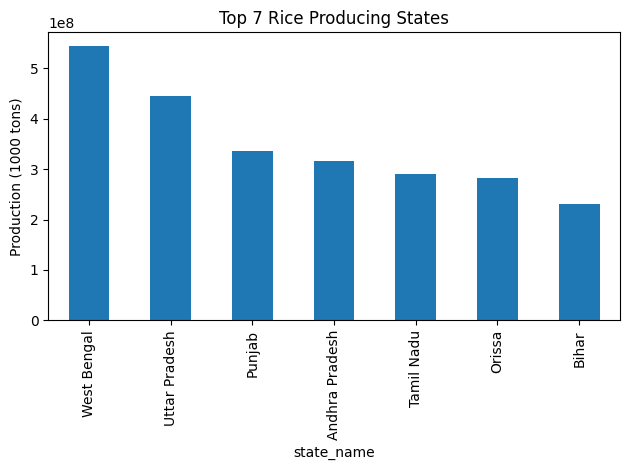

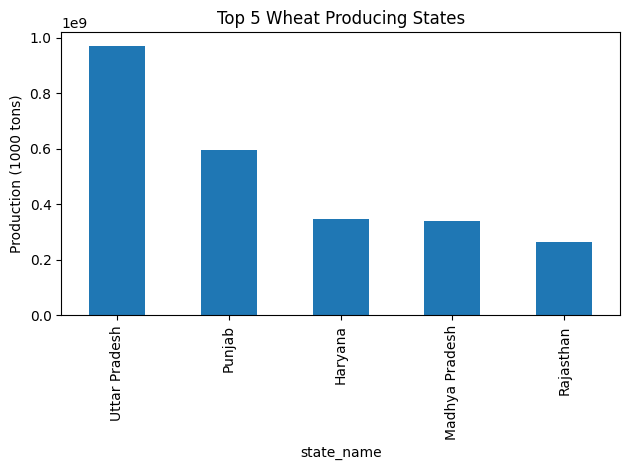

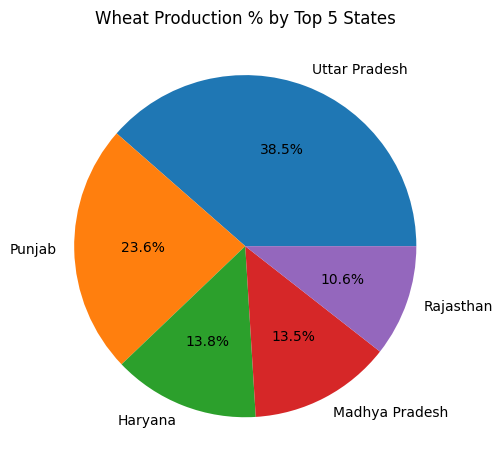

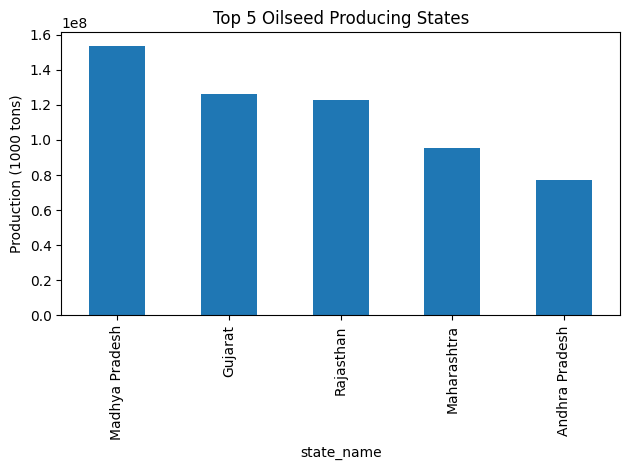

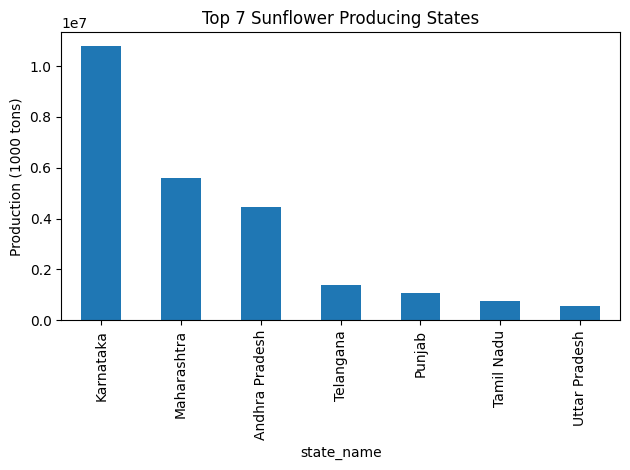

...

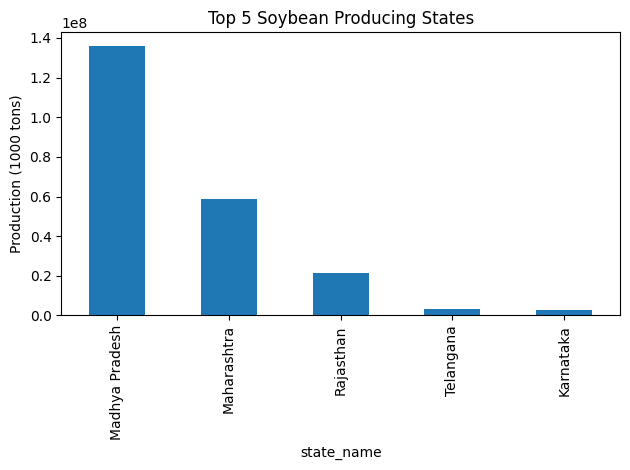

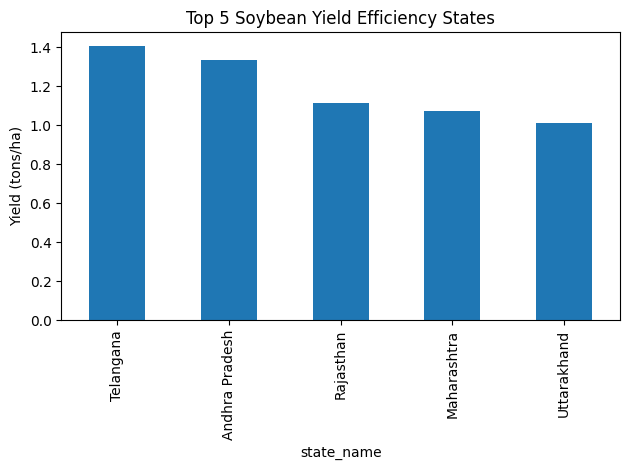

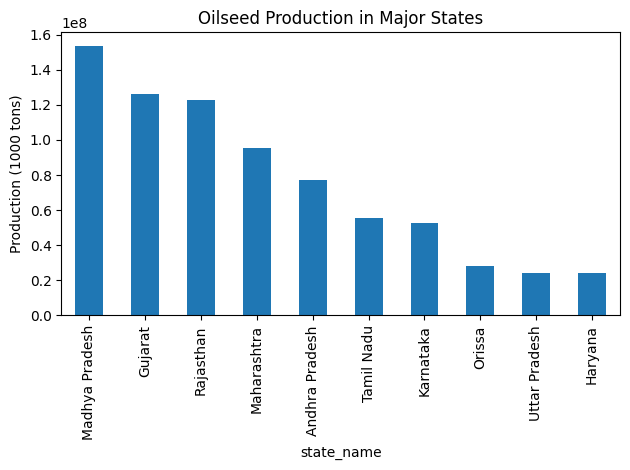

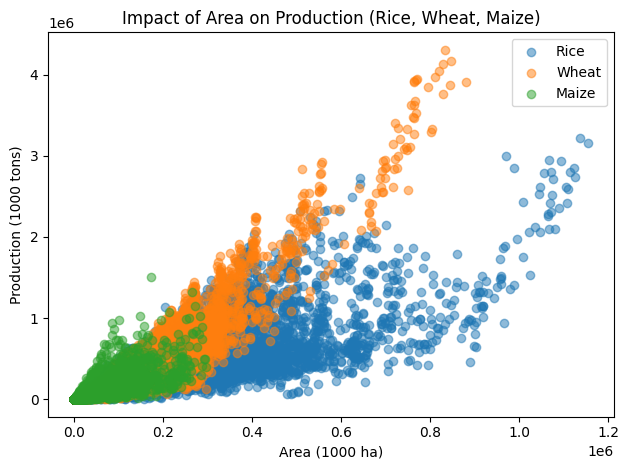

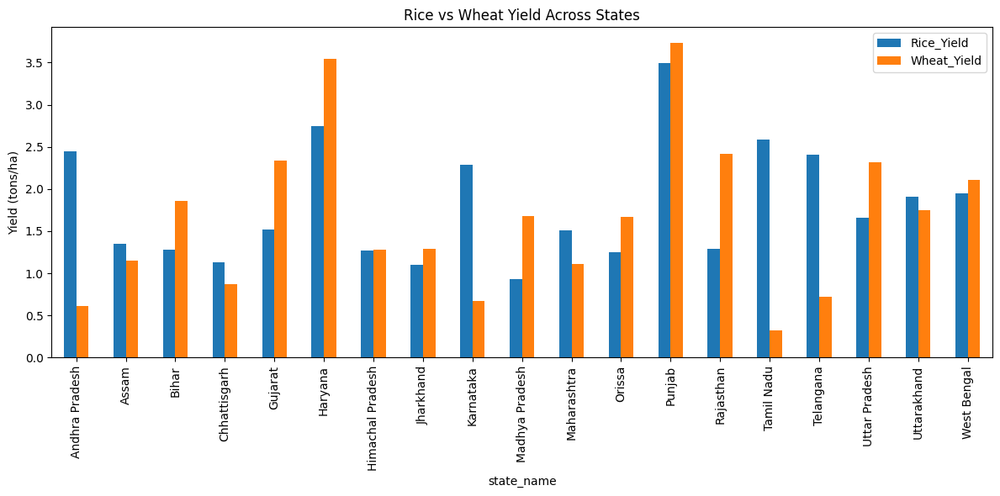

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import warnings

# Ignore warnings for cleaner output
warnings.filterwarnings("ignore", category=RuntimeWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Load dataset
df = pd.read_csv('agri1_cleaned.csv')

# Preview
print(df.head())

# ----- 1. Top 7 Rice Producing States -----
rice_by_state = df.groupby('state_name')['rice_production_1000_tons'].sum().sort_values(ascending=False).head(7)
rice_by_state.plot(kind='bar', title='Top 7 Rice Producing States', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 2. Top 5 Wheat Producing States (Bar + Pie Chart) -----
wheat_by_state = df.groupby('state_name')['wheat_production_1000_tons'].sum().sort_values(ascending=False).head(5)

# Bar Chart
wheat_by_state.plot(kind='bar', title='Top 5 Wheat Producing States', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# Pie Chart
wheat_by_state.plot(kind='pie', autopct='%1.1f%%', title='Wheat Production % by Top 5 States')
plt.ylabel('')
plt.tight_layout()
plt.show()

# ----- 3. Oilseed Production by Top 5 States -----
oilseed_by_state = df.groupby('state_name')['oilseeds_production_1000_tons'].sum().sort_values(ascending=False).head(5)
oilseed_by_state.plot(kind='bar', title='Top 5 Oilseed Producing States', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 4. Top 7 Sunflower Producing States -----
sunflower_by_state = df.groupby('state_name')['sunflower_production_1000_tons'].sum().sort_values(ascending=False).head(7)
sunflower_by_state.plot(kind='bar', title='Top 7 Sunflower Producing States', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 5. Sugarcane Production Over 50 Years -----
sugarcane_trend = df.groupby('year')['sugarcane_production_1000_tons'].sum()
sugarcane_trend.plot(title="India's Sugarcane Production (50 Years)", ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 6. Rice vs Wheat Production Over 50 Years -----
rice_trend = df.groupby('year')['rice_production_1000_tons'].sum()
wheat_trend = df.groupby('year')['wheat_production_1000_tons'].sum()
plt.plot(rice_trend.index, rice_trend.values, label='Rice')
plt.plot(wheat_trend.index, wheat_trend.values, label='Wheat')
plt.title('Rice vs Wheat Production Over 50 Years')
plt.xlabel('Year')
plt.ylabel('Production (1000 tons)')
plt.legend()
plt.tight_layout()
plt.show()

# ----- 7. Rice Production by West Bengal Districts -----
wb_rice = df[df['state_name'] == 'West Bengal'].groupby('dist_name')['rice_production_1000_tons'].sum().sort_values(ascending=False)
wb_rice.plot(kind='bar', title='Rice Production by Districts in West Bengal', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 8. Top 10 Wheat Production Years from UP -----
up_wheat = df[df['state_name'] == 'Uttar Pradesh']
up_wheat_years = up_wheat.groupby('year')['wheat_production_1000_tons'].sum().sort_values(ascending=False).head(10)
up_wheat_years.plot(kind='bar', title='Top 10 Wheat Production Years in UP', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 9. Millet Production Over 50 Years -----
# Millet columns are not clearly provided; using sum of all millets
millet_columns = [
    'pearl_millet_production_1000_tons', 
    'maize_production_1000_tons', 
    'finger_millet_production_1000_tons'
]
df['millet_production_1000_tons'] = df[millet_columns].sum(axis=1)

millet_trend = df.groupby('year')['millet_production_1000_tons'].sum()
millet_trend.plot(title='Millet Production Over 50 Years', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 10. Sorghum Production (Kharif and Rabi) by Region -----
sorghum_kharif = df.groupby('state_name')['kharif_sorghum_production_1000_tons'].sum()
sorghum_rabi = df.groupby('state_name')['rabi_sorghum_production_1000_tons'].sum()
sorghum_combined = pd.concat([sorghum_kharif, sorghum_rabi], axis=1, keys=['Kharif', 'Rabi']).fillna(0)
sorghum_combined.plot(kind='bar', title='Sorghum Production (Kharif vs Rabi)', ylabel='Production (1000 tons)', figsize=(12,6))
plt.tight_layout()
plt.show()

# ----- 11. Top 7 States for Groundnut Production -----
groundnut_by_state = df.groupby('state_name')['groundnut_production_1000_tons'].sum().sort_values(ascending=False).head(7)
groundnut_by_state.plot(kind='bar', title='Top 7 Groundnut Producing States', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 12. Soybean Production by Top 5 States and Yield Efficiency -----
soybean_by_state = df.groupby('state_name')['soyabean_production_1000_tons'].sum().sort_values(ascending=False).head(5)
soybean_by_state.plot(kind='bar', title='Top 5 Soybean Producing States', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# Yield Efficiency = Production / Area
soy_yield_eff = df.groupby('state_name').apply(
    lambda x: x['soyabean_production_1000_tons'].sum() / x['soyabean_area_1000_ha'].sum()
).sort_values(ascending=False).head(5)

soy_yield_eff.plot(kind='bar', title='Top 5 Soybean Yield Efficiency States', ylabel='Yield (tons/ha)')
plt.tight_layout()
plt.show()

# ----- 13. Oilseed Production in Major States -----
oilseed_major = df.groupby('state_name')['oilseeds_production_1000_tons'].sum().sort_values(ascending=False).head(10)
oilseed_major.plot(kind='bar', title='Oilseed Production in Major States', ylabel='Production (1000 tons)')
plt.tight_layout()
plt.show()

# ----- 14. Impact of Area Cultivated on Production -----
for crop in ['rice', 'wheat', 'maize']:
    area_col = f'{crop}_area_1000_ha'
    prod_col = f'{crop}_production_1000_tons'
    plt.scatter(df[area_col], df[prod_col], label=crop.capitalize(), alpha=0.5)

plt.xlabel('Area (1000 ha)')
plt.ylabel('Production (1000 tons)')
plt.title('Impact of Area on Production (Rice, Wheat, Maize)')
plt.legend()
plt.tight_layout()
plt.show()

# ----- 15. Rice vs Wheat Yield Across States -----
rice_yield_state = df.groupby('state_name').apply(
    lambda x: x['rice_production_1000_tons'].sum() / x['rice_area_1000_ha'].sum()
)

wheat_yield_state = df.groupby('state_name').apply(
    lambda x: x['wheat_production_1000_tons'].sum() / x['wheat_area_1000_ha'].sum()
)

yield_compare = pd.concat([rice_yield_state, wheat_yield_state], axis=1, keys=['Rice_Yield', 'Wheat_Yield']).dropna()
yield_compare.plot(kind='bar', figsize=(12,6), title='Rice vs Wheat Yield Across States', ylabel='Yield (tons/ha)')
plt.tight_layout()
plt.show()


In [18]:
import mysql.connector
import pandas as pd

# Establish connection
connection = mysql.connector.connect(
    host="gateway01.ap-southeast-1.prod.aws.tidbcloud.com",
    port=4000,
    user="2rrW5N2MLfbGdMz.root",
    password="P4bsQKQohFuSXOLc",
    database="proj",
)

# Create a cursor object
cursor = connection.cursor()

# Create table SQL (match the previous table creation script)
create_table_query = """
CREATE TABLE IF NOT EXISTS agricultural_data (
    dist_code FLOAT,
    `year` FLOAT,
    state_code FLOAT,
    state_name VARCHAR(255),
    dist_name VARCHAR(255),
    rice_area_1000_ha FLOAT,
    rice_production_1000_tons FLOAT,
    rice_yield_kg_per_ha FLOAT,
    wheat_area_1000_ha FLOAT,
    wheat_production_1000_tons FLOAT,
    wheat_yield_kg_per_ha FLOAT,
    kharif_sorghum_area_1000_ha FLOAT,
    kharif_sorghum_production_1000_tons FLOAT,
    kharif_sorghum_yield_kg_per_ha FLOAT,
    rabi_sorghum_area_1000_ha FLOAT,
    rabi_sorghum_production_1000_tons FLOAT,
    rabi_sorghum_yield_kg_per_ha FLOAT,
    sorghum_area_1000_ha FLOAT,
    sorghum_production_1000_tons FLOAT,
    sorghum_yield_kg_per_ha FLOAT,
    pearl_millet_area_1000_ha FLOAT,
    pearl_millet_production_1000_tons FLOAT,
    pearl_millet_yield_kg_per_ha FLOAT,
    maize_area_1000_ha FLOAT,
    maize_production_1000_tons FLOAT,
    maize_yield_kg_per_ha FLOAT,
    finger_millet_area_1000_ha FLOAT,
    finger_millet_production_1000_tons FLOAT,
    finger_millet_yield_kg_per_ha FLOAT,
    barley_area_1000_ha FLOAT,
    barley_production_1000_tons FLOAT,
    barley_yield_kg_per_ha FLOAT,
    chickpea_area_1000_ha FLOAT,
    chickpea_production_1000_tons FLOAT,
    chickpea_yield_kg_per_ha FLOAT,
    pigeonpea_area_1000_ha FLOAT,
    pigeonpea_production_1000_tons FLOAT,
    pigeonpea_yield_kg_per_ha FLOAT,
    minor_pulses_area_1000_ha FLOAT,
    minor_pulses_production_1000_tons FLOAT,
    minor_pulses_yield_kg_per_ha FLOAT,
    groundnut_area_1000_ha FLOAT,
    groundnut_production_1000_tons FLOAT,
    groundnut_yield_kg_per_ha FLOAT,
    sesamum_area_1000_ha FLOAT,
    sesamum_production_1000_tons FLOAT,
    sesamum_yield_kg_per_ha FLOAT,
    rapeseed_and_mustard_area_1000_ha FLOAT,
    rapeseed_and_mustard_production_1000_tons FLOAT,
    rapeseed_and_mustard_yield_kg_per_ha FLOAT,
    safflower_area_1000_ha FLOAT,
    safflower_production_1000_tons FLOAT,
    safflower_yield_kg_per_ha FLOAT,
    castor_area_1000_ha FLOAT,
    castor_production_1000_tons FLOAT,
    castor_yield_kg_per_ha FLOAT,
    linseed_area_1000_ha FLOAT,
    linseed_production_1000_tons FLOAT,
    linseed_yield_kg_per_ha FLOAT,
    sunflower_area_1000_ha FLOAT,
    sunflower_production_1000_tons FLOAT,
    sunflower_yield_kg_per_ha FLOAT,
    soyabean_area_1000_ha FLOAT,
    soyabean_production_1000_tons FLOAT,
    soyabean_yield_kg_per_ha FLOAT,
    oilseeds_area_1000_ha FLOAT,
    oilseeds_production_1000_tons FLOAT,
    oilseeds_yield_kg_per_ha FLOAT,
    sugarcane_area_1000_ha FLOAT,
    sugarcane_production_1000_tons FLOAT,
    sugarcane_yield_kg_per_ha FLOAT,
    cotton_area_1000_ha FLOAT,
    cotton_production_1000_tons FLOAT,
    cotton_yield_kg_per_ha FLOAT,
    fruits_area_1000_ha FLOAT,
    vegetables_area_1000_ha FLOAT,
    fruits_and_vegetables_area_1000_ha FLOAT,
    potatoes_area_1000_ha FLOAT,
    onion_area_1000_ha FLOAT,
    fodder_area_1000_ha FLOAT,
    calculated_rice_yield_kg_per_ha FLOAT,
    calculated_wheat_yield_kg_per_ha FLOAT,
    calculated_kharif_sorghum_yield_kg_per_ha FLOAT,
    calculated_rabi_sorghum_yield_kg_per_ha FLOAT,
    calculated_sorghum_yield_kg_per_ha FLOAT,
    calculated_pearl_millet_yield_kg_per_ha FLOAT,
    calculated_maize_yield_kg_per_ha FLOAT,
    calculated_finger_millet_yield_kg_per_ha FLOAT,
    calculated_barley_yield_kg_per_ha FLOAT,
    calculated_chickpea_yield_kg_per_ha FLOAT,
    calculated_pigeonpea_yield_kg_per_ha FLOAT,
    calculated_minor_pulses_yield_kg_per_ha FLOAT,
    calculated_groundnut_yield_kg_per_ha FLOAT,
    calculated_sesamum_yield_kg_per_ha FLOAT,
    calculated_rapeseed_and_mustard_yield_kg_per_ha FLOAT,
    calculated_safflower_yield_kg_per_ha FLOAT,
    calculated_castor_yield_kg_per_ha FLOAT,
    calculated_linseed_yield_kg_per_ha FLOAT,
    calculated_sunflower_yield_kg_per_ha FLOAT,
    calculated_soyabean_yield_kg_per_ha FLOAT,
    calculated_oilseeds_yield_kg_per_ha FLOAT,
    calculated_sugarcane_yield_kg_per_ha FLOAT,
    calculated_cotton_yield_kg_per_ha FLOAT,
    millet_production_1000_tons FLOAT
)
"""

try:
    # Create table
    cursor.execute(create_table_query)
    print("Table created successfully or already exists.")
    connection.commit()

    # Load your data (modify this part based on your actual data source)
    # For example, reading from a CSV
    df = pd.read_csv('agri1_cleaned.csv')  # Replace with your actual data file

    # Prepare the INSERT statement dynamically
    columns = df.columns.tolist()
    placeholders = ', '.join(['%s'] * len(columns))
    insert_query = f"INSERT INTO agricultural_data ({', '.join(columns)}) VALUES ({placeholders})"

    # Insert data in batches
    batch_size = 1000
    for i in range(0, len(df), batch_size):
        batch = df.iloc[i:i+batch_size]
        
        # Convert batch to list of tuples
        records = batch.to_records(index=False).tolist()
        
        try:
            # Execute batch insert
            cursor.executemany(insert_query, records)
            connection.commit()
            print(f"Inserted batch {i//batch_size + 1}")
        except mysql.connector.Error as err:
            print(f"Error inserting batch: {err}")
            connection.rollback()

except mysql.connector.Error as err:
    print(f"Error creating table: {err}")

Table created successfully or already exists.
Inserted batch 1
Inserted batch 2
Inserted batch 3
Inserted batch 4
Inserted batch 5
Inserted batch 6
Inserted batch 7
Inserted batch 8
Inserted batch 9
Inserted batch 10
Inserted batch 11
Inserted batch 12
Inserted batch 13
Inserted batch 14
Inserted batch 15
Inserted batch 16
Inserted batch 17


In [19]:
import mysql.connector
import pandas as pd
from tabulate import tabulate

# ✅ Establish connection
connection = mysql.connector.connect(
    host="gateway01.ap-southeast-1.prod.aws.tidbcloud.com",
    port=4000,
    user="2rrW5N2MLfbGdMz.root",
    password="P4bsQKQohFuSXOLc",
    database="proj"
)

# ✅ Create a buffered cursor to avoid unread results error
cursor = connection.cursor(buffered=True)



In [21]:
cursor.execute("""
-- Subquery to get top 5 states by total production
SELECT 
    a.state_name,
    a.year,
    SUM(a.rice_production_1000_tons) AS rice_production,
    SUM(a.wheat_production_1000_tons) AS wheat_production
FROM agricultural_data a
JOIN (
    -- Subquery to get top 5 states based on rice + wheat production
    SELECT 
        state_name
    FROM agricultural_data
    GROUP BY state_name
    ORDER BY SUM(rice_production_1000_tons + wheat_production_1000_tons) DESC
    LIMIT 5
) top_states ON a.state_name = top_states.state_name
GROUP BY a.state_name, a.year
ORDER BY a.state_name, a.year;


""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))

+-----+----------------+--------+-------------------+--------------------+
|     | state_name     |   year |   rice_production |   wheat_production |
|-----+----------------+--------+-------------------+--------------------|
|   0 | Haryana        |   1966 |  226200           |        1.104e+06   |
|   1 | Haryana        |   1967 |  293000           |        1.484e+06   |
|   2 | Haryana        |   1968 |  277500           |        1.6226e+06  |
|   3 | Haryana        |   1969 |  372200           |        2.213e+06   |
|   4 | Haryana        |   1970 |  458000           |        2.455e+06   |
|   5 | Haryana        |   1971 |  540000           |        2.477e+06   |
|   6 | Haryana        |   1972 |  475000           |        2.325e+06   |
|   7 | Haryana        |   1973 |  557000           |        1.928e+06   |
|   8 | Haryana        |   1974 |  402000           |        2.067e+06   |
|   9 | Haryana        |   1975 |  641000           |        2.558e+06   |
|  10 | Haryana        | 

In [22]:
cursor.execute("""
SELECT 
    dist_name, 
    state_name,
    ROUND(AVG(rice_yield_kg_per_ha), 2) as avg_rice_yield
FROM agricultural_data
GROUP BY dist_name, state_name
ORDER BY avg_rice_yield DESC
LIMIT 10;
""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))


+----+--------------+--------------+------------------+
|    | dist_name    | state_name   |   avg_rice_yield |
|----+--------------+--------------+------------------|
|  0 | Ludhiana     | Punjab       |          3650.43 |
|  1 | Sangrur      | Punjab       |          3532.9  |
|  2 | Thirunelveli | Tamil Nadu   |          3387.51 |
|  3 | Bhatinda     | Punjab       |          3363.16 |
|  4 | Madurai      | Tamil Nadu   |          3276.98 |
|  5 | Kanyakumari  | Tamil Nadu   |          3240.69 |
|  6 | Ferozpur     | Punjab       |          3234.06 |
|  7 | Patiala      | Punjab       |          3222.13 |
|  8 | Jalandhar    | Punjab       |          3187.03 |
|  9 | Salem        | Tamil Nadu   |          3102.58 |
+----+--------------+--------------+------------------+


In [23]:
cursor.execute("""
SELECT 
    state_name,
    ROUND(SUM(oilseeds_area_1000_ha), 2) as total_oilseed_area
FROM agricultural_data
GROUP BY state_name
ORDER BY total_oilseed_area DESC
LIMIT 10;


""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))


+----+----------------+----------------------+
|    | state_name     |   total_oilseed_area |
|----+----------------+----------------------|
|  0 | Madhya Pradesh |          1.89946e+08 |
|  1 | Rajasthan      |          1.42433e+08 |
|  2 | Maharashtra    |          1.34069e+08 |
|  3 | Gujarat        |          1.30725e+08 |
|  4 | Karnataka      |          9.25272e+07 |
|  5 | Andhra Pradesh |          8.72235e+07 |
|  6 | Tamil Nadu     |          5.62256e+07 |
|  7 | Uttar Pradesh  |          4.30471e+07 |
|  8 | Orissa         |          3.9682e+07  |
|  9 | Telangana      |          3.52934e+07 |
+----+----------------+----------------------+


In [24]:
cursor.execute("""
SELECT 
    state_name,
    ROUND(AVG(maize_yield_kg_per_ha), 2) as avg_maize_yield
FROM agricultural_data
GROUP BY state_name
ORDER BY avg_maize_yield DESC
LIMIT 10;

""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))


+----+------------------+-------------------+
|    | state_name       |   avg_maize_yield |
|----+------------------+-------------------|
|  0 | Andhra Pradesh   |           3124.9  |
|  1 | Karnataka        |           2609.56 |
|  2 | Telangana        |           2338.19 |
|  3 | Punjab           |           2070.73 |
|  4 | Himachal Pradesh |           1936.66 |
|  5 | Bihar            |           1873.98 |
|  6 | Tamil Nadu       |           1808.19 |
|  7 | West Bengal      |           1584.51 |
|  8 | Maharashtra      |           1288.76 |
|  9 | Chhattisgarh     |           1282.81 |
+----+------------------+-------------------+


In [25]:
cursor.execute("""
WITH TopCottonStates AS (
    SELECT state_name
    FROM agricultural_data
    GROUP BY state_name
    ORDER BY MAX(cotton_production_1000_tons) DESC
    LIMIT 5
),
StateCottonProduction AS (
    SELECT 
        a.state_name, 
        a.year, 
        a.cotton_production_1000_tons,
        LAG(a.cotton_production_1000_tons) OVER (PARTITION BY a.state_name ORDER BY a.year) as prev_production
    FROM agricultural_data a
    JOIN TopCottonStates t ON a.state_name = t.state_name
)
SELECT 
    state_name, 
    year, 
    cotton_production_1000_tons,
    ROUND(((cotton_production_1000_tons - prev_production) / prev_production * 100), 2) as growth_percentage
FROM StateCottonProduction
WHERE prev_production IS NOT NULL
ORDER BY state_name, year;

""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))


+------+----------------+--------+-------------------------------+---------------------+
|      | state_name     |   year |   cotton_production_1000_tons |   growth_percentage |
|------+----------------+--------+-------------------------------+---------------------|
|    0 | Andhra Pradesh |   1966 |                         10000 |             3233.33 |
|    1 | Andhra Pradesh |   1966 |                             0 |             -100    |
|    2 | Andhra Pradesh |   1966 |                          1000 |              nan    |
|    3 | Andhra Pradesh |   1966 |                          2000 |              100    |
|    4 | Andhra Pradesh |   1966 |                           400 |              -80    |
|    5 | Andhra Pradesh |   1966 |                             0 |             -100    |
|    6 | Andhra Pradesh |   1966 |                             0 |              nan    |
|    7 | Andhra Pradesh |   1966 |                          1000 |              nan    |
|    8 | Andhra Prade

In [26]:





cursor.execute("""
SELECT 
    dist_name,
    (COUNT(*) * SUM(rice_area_1000_ha * rice_production_1000_tons) - SUM(rice_area_1000_ha) * SUM(rice_production_1000_tons)) /
    (SQRT((COUNT(*) * SUM(POW(rice_area_1000_ha, 2)) - POW(SUM(rice_area_1000_ha), 2)) * 
          (COUNT(*) * SUM(POW(rice_production_1000_tons, 2)) - POW(SUM(rice_production_1000_tons), 2)))) AS rice_correlation,
    
    (COUNT(*) * SUM(wheat_area_1000_ha * wheat_production_1000_tons) - SUM(wheat_area_1000_ha) * SUM(wheat_production_1000_tons)) /
    (SQRT((COUNT(*) * SUM(POW(wheat_area_1000_ha, 2)) - POW(SUM(wheat_area_1000_ha), 2)) * 
          (COUNT(*) * SUM(POW(wheat_production_1000_tons, 2)) - POW(SUM(wheat_production_1000_tons), 2)))) AS wheat_correlation,

    (COUNT(*) * SUM(maize_area_1000_ha * maize_production_1000_tons) - SUM(maize_area_1000_ha) * SUM(maize_production_1000_tons)) /
    (SQRT((COUNT(*) * SUM(POW(maize_area_1000_ha, 2)) - POW(SUM(maize_area_1000_ha), 2)) * 
          (COUNT(*) * SUM(POW(maize_production_1000_tons, 2)) - POW(SUM(maize_production_1000_tons), 2)))) AS maize_correlation
FROM agricultural_data
GROUP BY dist_name
ORDER BY dist_name;


""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))


+-----+-----------------------------------------+--------------------+---------------------+---------------------+
|     | dist_name                               |   rice_correlation |   wheat_correlation |   maize_correlation |
|-----+-----------------------------------------+--------------------+---------------------+---------------------|
|   0 | 24 Parganas                             |         0.451063   |         0.805426    |          0.875017   |
|   1 | Adilabad                                |         0.815215   |         0.381896    |          0.683648   |
|   2 | Agra                                    |         0.977809   |         0.8627      |          0.505339   |
|   3 | Ahmedabad                               |         0.937127   |         0.88958     |          0.873605   |
|   4 | Ahmednagar                              |         0.752331   |         0.922799    |          0.946715   |
|   5 | Ajmer                                   |         0.429769   |         0

In [27]:




cursor.execute("""
WITH StateProdution AS (
    SELECT 
        state_name,
        MIN(year) as start_year,
        MAX(year) as end_year,
        MIN(oilseeds_production_1000_tons) as start_production,
        MAX(oilseeds_production_1000_tons) as end_production
    FROM agricultural_data
    GROUP BY state_name
)
SELECT 
    state_name,
    start_year,
    end_year,
    start_production,
    end_production,
    ROUND(((end_production - start_production) / start_production * 100), 2) as growth_percentage
FROM StateProdution
WHERE start_production > 0
ORDER BY growth_percentage DESC
LIMIT 5;
""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))



+----+----------------+--------------+------------+--------------------+------------------+---------------------+
|    | state_name     |   start_year |   end_year |   start_production |   end_production |   growth_percentage |
|----+----------------+--------------+------------+--------------------+------------------+---------------------|
|  0 | Andhra Pradesh |         1966 |       2017 |               1000 |      1.16061e+06 |            115961   |
|  1 | Orissa         |         1966 |       2017 |               1260 | 200250           |             15792.9 |
+----+----------------+--------------+------------+--------------------+------------------+---------------------+


In [28]:
cursor.execute("""
WITH YieldComparison AS (
    SELECT 
        dist_name,
        MIN(year) as start_year,
        MAX(year) as end_year,
        MIN(wheat_yield_kg_per_ha) as start_yield,
        MAX(wheat_yield_kg_per_ha) as end_yield
    FROM agricultural_data
    GROUP BY dist_name
)
SELECT 
    dist_name,
    start_year,
    end_year,
    start_yield,
    end_yield,
    ROUND(((end_yield - start_yield) / start_yield * 100), 2) as yield_increase_percentage
FROM YieldComparison
WHERE start_yield > 0
ORDER BY yield_increase_percentage DESC
LIMIT 5;
""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))


+----+-------------+--------------+------------+---------------+-------------+-----------------------------+
|    | dist_name   |   start_year |   end_year |   start_yield |   end_yield |   yield_increase_percentage |
|----+-------------+--------------+------------+---------------+-------------+-----------------------------|
|  0 | Gaya        |         1966 |       2017 |         46.11 |     2840.14 |                     6059.49 |
|  1 | Adilabad    |         1966 |       2017 |        111.11 |     4882.78 |                     4294.55 |
|  2 | Sidhi       |         1966 |       2017 |         71.43 |     2771.19 |                     3779.59 |
|  3 | Hyderabad   |         1966 |       2017 |        111.11 |     3900    |                     3410.04 |
|  4 | Buldhana    |         1966 |       2017 |         74.32 |     2105.26 |                     2732.7  |
+----+-------------+--------------+------------+---------------+-------------+-----------------------------+


In [29]:


cursor.execute("""
SELECT 
    year,                                  
    state_name,                            
    SUM(rice_production_1000_tons) AS total_rice_production  
FROM agricultural_data                      
GROUP BY year, state_name                  
ORDER BY year, total_rice_production DESC  
LIMIT 3;
""")
results = cursor.fetchall()
columns = [desc[0] for desc in cursor.description]
df = pd.DataFrame(results, columns=columns)
print(tabulate(df, headers='keys', tablefmt='psql'))





+----+--------+--------------+-------------------------+
|    |   year | state_name   |   total_rice_production |
|----+--------+--------------+-------------------------|
|  0 |   1966 | West Bengal  |             4.8194e+06  |
|  1 |   1966 | Tamil Nadu   |             3.793e+06   |
|  2 |   1966 | Orissa       |             3.69179e+06 |
+----+--------+--------------+-------------------------+
